This dataset will be one of the ramifications the Data Processing step.

In this, the authors will explore clustering with the aid of a probabilistic model: Gaussian Mixture Models that uses the Expectation Maximization algorithm. 

For faster computation, all EDA vizualizations will be commented.

In [1]:
#import libraries

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import sklearn
import seaborn as sns
from scipy import stats

from datetime import date
from datetime import datetime
from matplotlib import pyplot as plt
import matplotlib.cm as cm
##SKlearn
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder,normalize
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.mixture import GaussianMixture

sns.set()
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, normalize
#Shuffle donors for random state used:
from sklearn.utils import shuffle


#for interactive map

import chart_studio.plotly as py
import plotly.graph_objs as go #importing graphical objects
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

###warnings

import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()
    
from timeit import default_timer as timer

In [2]:
#import dataset of outlier removed observations saved in notebook 1

donors = pd.read_csv(r'C:\Users\Ricardo Santos\Documents\MSC DM\DM\Proj-DM\common_version\Outliers_Removed_notstd.csv', low_memory=False)
donors.head()

,CONTROLN,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,LONGEVITY,...,MAXRAMNT,AVGGIFT,PROP_RESP_CARDPROM,HHAGE3,HV2,HVP4,IC5,EC4,MARR3,AC3
0,4,12,0,0,0,0,0,0,0,132,...,50.0,14.928571,0.128205,20,937,63,14337,21,19,9
1,8,0,0,36,31,30,3,3,8,144,...,15.0,7.600000,0.272727,22,488,4,6596,34,12,6
2,17,0,0,0,0,0,0,0,0,144,...,26.0,20.571429,0.136364,21,582,21,10460,31,5,11
3,26,4,0,28,25,41,9,3,4,144,...,17.0,12.250000,0.125000,25,3513,99,34637,13,5,18
4,32,1,0,31,23,44,25,4,0,156,...,15.0,8.611111,0.228571,15,5214,99,73300,3,4,15


In [3]:
donors=donors.set_index('CONTROLN', drop = True).sort_index(axis = 0)

In [4]:
#check descriptive stats of the model
donors.describe()

,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,LONGEVITY,AGE,...,MAXRAMNT,AVGGIFT,PROP_RESP_CARDPROM,HHAGE3,HV2,HVP4,IC5,EC4,MARR3,AC3
count,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,...,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000
mean,3.329840,1.039080,30.629646,29.939962,32.711921,6.884901,4.613527,3.135024,117.649233,56.786229,...,17.148211,10.991399,0.242612,22.344187,1098.006210,50.103772,15448.123405,29.064338,7.428651,11.823553
std,9.148945,5.042595,11.232175,14.894814,17.470635,4.342127,5.128090,4.149617,38.535192,14.473918,...,7.206429,4.318486,0.121014,12.904224,909.904879,36.561553,8090.437124,10.176940,4.847604,4.931338
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,48.000000,19.000000,...,5.000000,1.285714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,25.000000,21.000000,21.000000,4.000000,1.000000,1.000000,84.000000,49.000000,...,12.000000,7.800000,0.153846,14.000000,548.000000,14.000000,10740.000000,22.000000,4.000000,9.000000
50%,0.000000,0.000000,31.000000,30.000000,32.000000,6.000000,3.000000,2.000000,120.000000,51.000000,...,15.000000,10.333333,0.227273,21.000000,787.000000,45.000000,13598.000000,30.000000,7.000000,12.000000
75%,3.000000,0.000000,37.000000,39.000000,43.000000,9.000000,6.000000,4.000000,156.000000,69.000000,...,20.000000,13.500000,0.320000,29.000000,1278.000000,91.000000,17873.250000,36.000000,9.000000,15.000000
max,241.000000,98.000000,99.000000,99.000000,99.000000,99.000000,99.000000,87.000000,192.000000,87.000000,...,111.000000,24.000000,0.593750,99.000000,6000.000000,99.000000,159306.000000,99.000000,73.000000,99.000000


In [5]:
#Shuffle according
donors = shuffle(donors, random_state = 15)

In [6]:
#donors_old is backup qith all features
donors_old = donors

In [7]:
#recover from removal
donors = donors_old

In [8]:
#remove avggift, Longevity and STATEGOV
 
donors = donors[["LONGEVITY","RAMNTALL","NGIFTALL","PROP_RESP_CARDPROM","HVP4","HV2","EC4"]]

In [11]:
#donors

Text(0.5, 0.98, 'Relationship Between Variables')

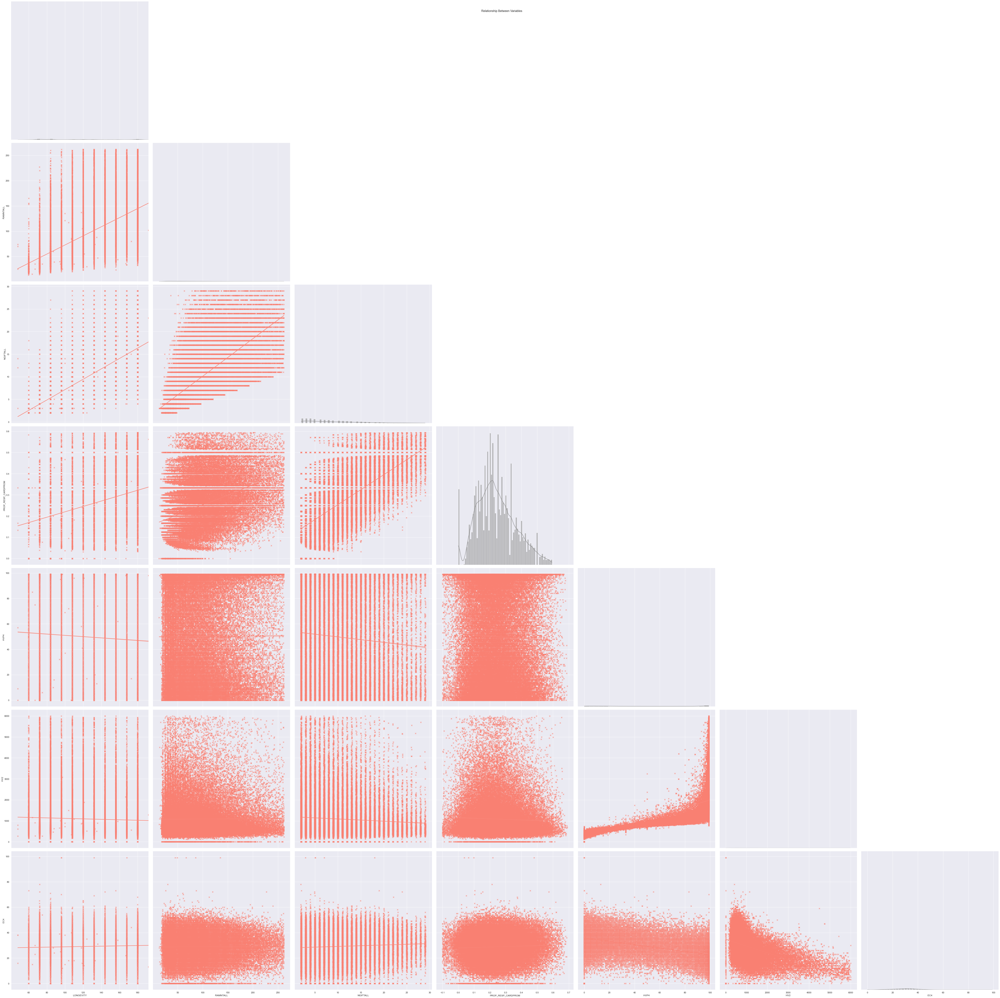

In [12]:
#hidden ofor faster computation

#perform a very simple pairplot
#We will use PairGrid - on diagonal row will see the variable distribution (will allow us to verify if it is possible to use standard scaler,
#on non-diagonal rows we have the relationship between the different variables
g = sns.PairGrid(donors, height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

In [13]:
#need top scale because of very different dimensionality between variables

# Get column names first
names = donors.columns

# Create the Scaler object

scaler = preprocessing.StandardScaler()

# Fit your data on the scaler object

scaled_df = scaler.fit_transform(donors)
scaled_df = pd.DataFrame(scaled_df, columns=names)
  
# Normalizing the Data 
normalized_df = normalize(scaled_df) 
  
# Converting the numpy array into a pandas DataFrame 
df_metrics = pd.DataFrame(normalized_df,columns=names) 

In [14]:
#some stats on scaled df

scaled_df

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4
0,-0.873215,-1.109146,-1.191215,-2.004836,0.489486,-0.305536,-0.792419
1,1.618034,1.256454,1.630697,0.127690,-1.096892,-0.695689,0.190202
2,1.618034,2.921836,2.792661,2.752958,0.817702,0.050548,0.386727
3,-0.561809,-0.522477,-0.361241,0.749676,1.200621,0.156055,-0.301108
4,0.061004,-0.749575,0.136744,-0.546565,-0.331054,-0.391260,0.878037
...,...,...,...,...,...,...,...
64887,1.618034,-0.579252,1.132713,1.361790,1.337378,0.411028,0.484989
64888,-0.873215,2.070220,2.128682,2.586018,1.310026,0.057142,-0.595895
64889,0.061004,-0.352154,-0.693230,-0.627580,-0.905433,-0.653926,1.074561
64890,-0.561809,-0.730650,-0.859225,-0.971894,-0.686622,-0.462696,0.190202


Text(0.5, 0.98, 'Relationship Between Variables')

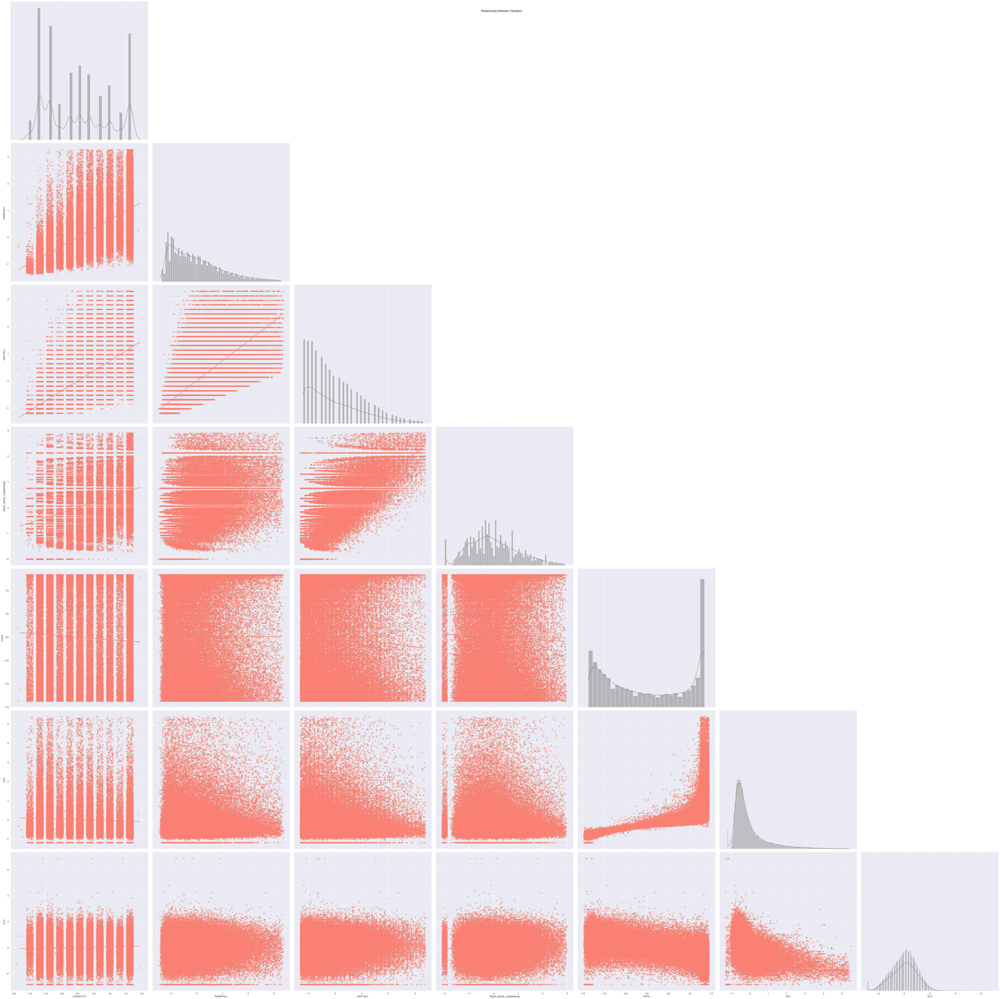

In [15]:
#hidden again

#perform a very simple pairplot
#We will use PairGrid - on diagonal row will see the variable distribution (will allow us to verify if it is possible to use standard scaler,
#on non-diagonal rows we have the relationship between the different variables
g = sns.PairGrid(scaled_df, height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

In [16]:
df_metrics.describe()

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4
count,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000,64892.000000
mean,-0.016472,-0.029147,-0.037323,-0.028253,-0.011093,-0.046781,0.019741
std,0.404544,0.370166,0.358435,0.381038,0.419839,0.313278,0.381117
min,-0.960320,-0.957036,-0.816419,-0.970387,-0.867200,-0.772946,-0.984736
25%,-0.392303,-0.347482,-0.352216,-0.329904,-0.393550,-0.264936,-0.273741
50%,0.014326,-0.102141,-0.118755,-0.053177,-0.061815,-0.153722,0.034287
75%,0.340963,0.248810,0.262942,0.267683,0.387624,0.085358,0.310856
max,0.969540,0.980836,0.937886,0.975634,0.980950,0.952715,0.976293


Text(0.5, 0.98, 'Relationship Between Variables')

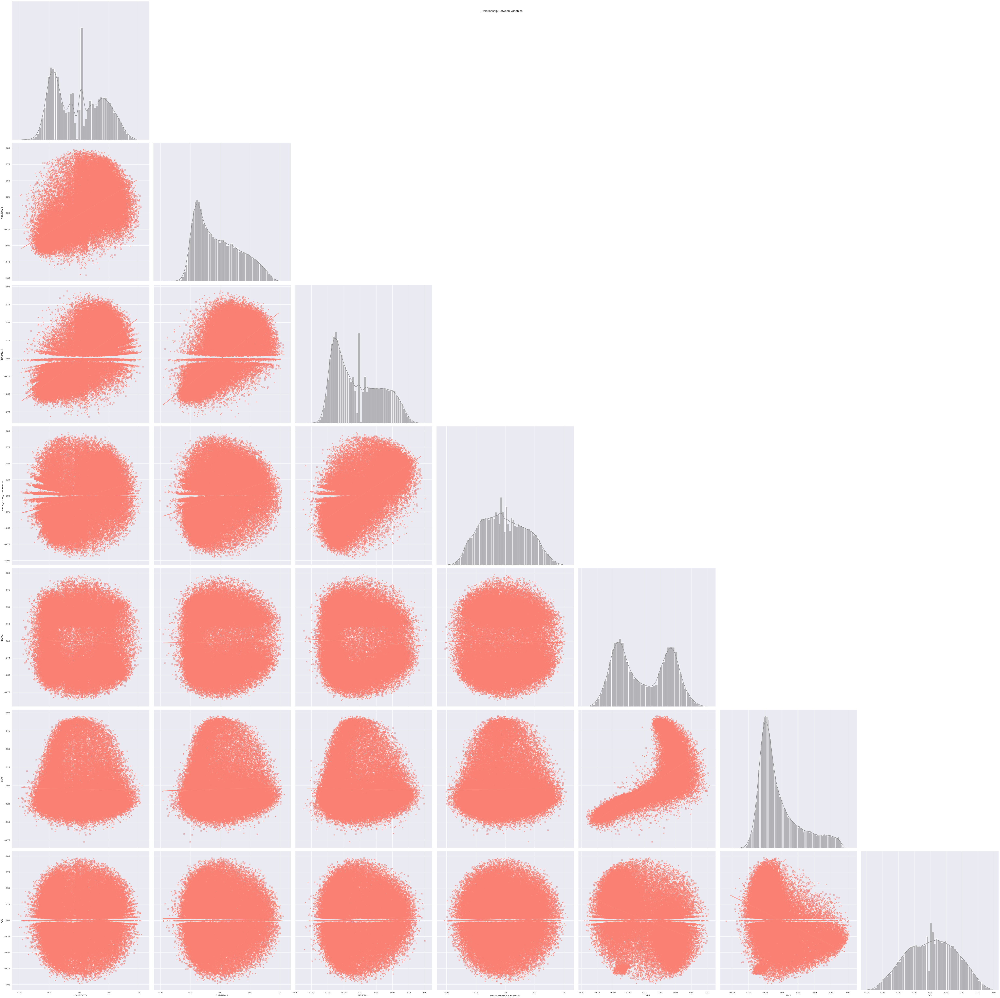

In [17]:
#perform a very simple pairplot for metrics
#We will use PairGrid - on diagonal row will see the variable distribution (will allow us to verify if it is possible to use standard scaler,
#on non-diagonal rows we have the relationship between the different variables
g = sns.PairGrid(df_metrics, height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

In [18]:
#in all tests, Full Covariance (where (each component has its own general covariance matrix)) gave the best results
#even though we could have approached the problem as a spherical cov problem, as an heuristic, it does make sense that each cluster has its own covariance matrix

#'''check source at: https://towardsdatascience.com/cheat-sheet-to-implementing-7-methods-for-selecting-optimal-number-of-clusters-in-python-898241e1d6ad

#Bayesian information criterion
#Bayesian information criterion (BIC) score is a method for scoring a model which is using the maximum likelihood estimation framework. The BIC statistic is calculated as follows:
#BIC = (k*ln(n)) — (2ln(L))
#where L is the maximized value of the likelihood function of the model, k is the number of parameters and n is the number of records
#The lower the BIC score, better is the model. We can use the BIC score for the Gaussian Mixture Modelling approach for clustering. We will discuss details of this model in a separate blog but key thing to note here is that in the model we need to select number of clusters as well as type of covariance. We try out various combinations of the parameters and select the model with the lowest BIC score.'''
#from sklearn.mixture import GaussianMixture

#check for ideal number of components
#n_components = range(1, 20)

#look for ideal covariance type and number of components:
#after all

#covariance_type = ['spherical', 'tied', 'diag', 'full']
#score=[]
#for cov in covariance_type:
    
#    print('Covariance type:', cov)
#    for n_comp in n_components:
#        gmm=GaussianMixture(n_components=n_comp, max_iter = 1000, verbose_interval = 100, covariance_type=cov, random_state = 15, verbose = True)
#        gmm.fit(df_metrics)
#        score.append((cov,n_comp,gmm.bic(df_metrics)))
#score

In [19]:

#Heuristic, find optimal initiation configuration by using kmeans initiation 10 times 
#GaussianMM selects the best scoring initiators

#Full Covariance gives the lowest values, so we plot AIC and BIC of the model with full covariance

#Find optimal initiator with for hypothetical 5 clusters 
GaussianMixture(n_components = 5, covariance_type='full', n_init = 10, max_iter = 1000, verbose_interval = 100, random_state = 15, verbose = 3).fit(df_metrics)


Initialization 0
Initialization converged: True	 time lapse 1.37800s	 ll 0.26938
Initialization 1
Initialization converged: True	 time lapse 1.33000s	 ll 0.26933
Initialization 2
Initialization converged: True	 time lapse 1.30900s	 ll 0.26930
Initialization 3
Initialization converged: True	 time lapse 1.34500s	 ll 0.26938
Initialization 4
Initialization converged: True	 time lapse 1.38100s	 ll 0.26937
Initialization 5
Initialization converged: True	 time lapse 3.13600s	 ll 0.22690
Initialization 6
Initialization converged: True	 time lapse 1.49101s	 ll 0.26943
Initialization 7
Initialization converged: True	 time lapse 1.46700s	 ll 0.26929
Initialization 8
Initialization converged: True	 time lapse 1.51100s	 ll 0.26931
Initialization 9
Initialization converged: True	 time lapse 1.89900s	 ll 0.26710


GaussianMixture(max_iter=1000, n_components=5, n_init=10, random_state=15,
                verbose=3, verbose_interval=100)

Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True
Initialization 0
Initialization converged: True


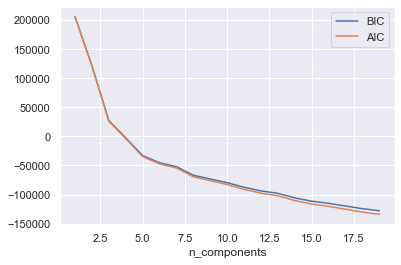

In [20]:
#find optimal number of componenets with previous initiation
#warm start allows to keep initiation from previous converging fit, which means that it will use the best scoring initiation,


#BIC AND AIC shoulg give an absolute minimum

n_components = np.arange(1, 20)
models = [GaussianMixture(n, covariance_type='full', warm_start = True, max_iter = 1000, verbose_interval = 100, random_state = 15, verbose = True).fit(df_metrics) for n in n_components]
plt.plot(n_components, [m.bic(df_metrics) for m in models], label='BIC')
plt.plot(n_components, [m.aic(df_metrics) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

In [21]:
#See 2 cells above for justification on comment

##check for ideal number of components
#n_components = range(1, 20)

#look for ideal covariance type and number of components:
#after all

#covariance_type = ['spherical', 'tied', 'diag', 'full']
#score=[]
#for cov in covariance_type:
#    
#    print('Covariance type:', cov)
#    for n_comp in n_components:
#        gmm=GaussianMixture(n_components=n_comp, max_iter = 1000, verbose_interval = 100, covariance_type=cov, random_state = 15, verbose = True)
#        gmm.fit(scaled_df)
#        score.append((cov,n_comp,gmm.bic(scaled_df)))
#score

In [22]:
#Full Covariance gives the lowest values, so we plot AIC and BIC of the model with full covariance
#After several tests, normalized data kept performing better than scaled data 

#n_components = np.arange(2, 20)
#models = [GaussianMixture(n, covariance_type='full', max_iter = 1000, warm_start = True, verbose_interval = 100, random_state = 15, verbose = True).fit(scaled_df) for n in n_components]
#plt.plot(n_components, [m.bic(scaled_df) for m in models], label='BIC')
#plt.plot(n_components, [m.aic(scaled_df) for m in models], label='AIC')
#plt.legend(loc='best')
#plt.xlabel('n_components');

# Using Gaussian Mixture Models to Cluster:


We will cluster, make predicitions and see the score in order to evaluate the cluster's performance. Points of concern:

1. Number of clusters:

2. How to initialize:

Metrics to consider as evaluators:

### Silhouette score
Advantages
The score is bounded between -1 for incorrect clustering and +1 for highly dense clustering. Scores around zero indicate overlapping clusters.

The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster.

Drawbacks
The Silhouette Coefficient is generally higher for convex clusters than other concepts of clusters, such as density based clusters like those obtained through DBSCAN.


### Calinski-Harabasz index

The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster.

The score is fast to compute.

Drawbacks
The Calinski-Harabasz index is generally higher for convex clusters than other concepts of clusters, such as density based clusters like those obtained through DBSCAN.

In [23]:
# 6 components landed us in a local minima, not optimal, but will have to do for now
#Run Model
gmm = GaussianMixture(n_components=6, covariance_type='full', random_state=15, max_iter = 1000, warm_start = True, verbose_interval = 100, verbose = 3)
gmm.fit(df_metrics)


Initialization 0
Initialization converged: True	 time lapse 1.78200s	 ll 0.36747


GaussianMixture(max_iter=1000, n_components=6, random_state=15, verbose=3,
                verbose_interval=100, warm_start=True)

In [24]:
#predictions from gmm
labels = gmm.predict(df_metrics) #normalized
df_labeled = donors.copy() #not standardized nor normalized
normed_df_label = df_metrics.copy()

df_labeled['Cluster'] = labels
normed_df_label['Cluster'] = labels
#find probability

#get array of probabilities of data point being generated from another distribution
probs_gmm = gmm.predict_proba(df_metrics)
prob_cluster = probs_gmm.max(axis=1)

In [25]:
#very high probability of being assigned to the cluster they are assigned to

prob_cluster

array([0.99201842, 0.99248436, 0.94911792, ..., 0.99514495, 0.99757095,
       0.99640694])

In [26]:
# Silhouette score varies between -1 and 1

sklearn.metrics.silhouette_score(df_metrics, labels, random_state=15) #df_metrics usado para prever e o nd array das labels

0.13713134352409925

In [27]:
#surprisingly good result considering that silhouette score is low
from sklearn.metrics import calinski_harabasz_score

calinski_harabasz_score(df_metrics, labels) #df_metrics usado para prever e o nd array das labels

14556.685586674088

In [28]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(donors)  # get total sum of squares
ssw_labels = df_labeled.groupby(['Cluster']).apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
r2

0.7307457444864295

In [29]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(df_metrics)  # get total sum of squares
ssw_labels = normed_df_label.groupby(['Cluster']).apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
r2

0.5286825769959352

# Visualizations


In [30]:
#check assignments

df_labeled['Cluster'].value_counts()

0    16888
5    13495
3    11752
1    10068
4     7479
2     5210
Name: Cluster, dtype: int64

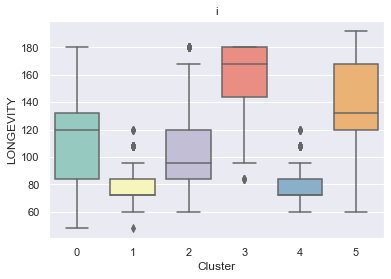

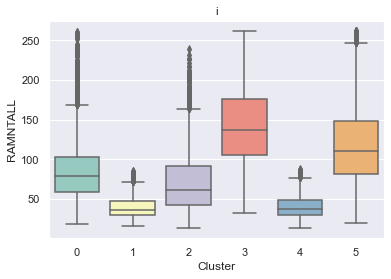

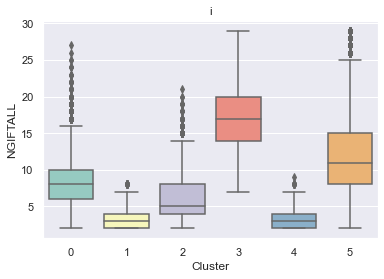

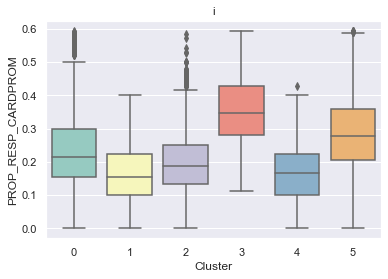

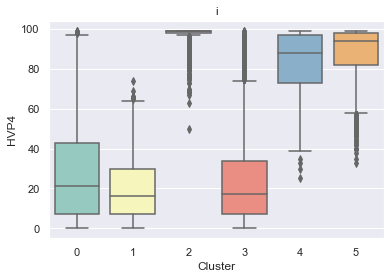

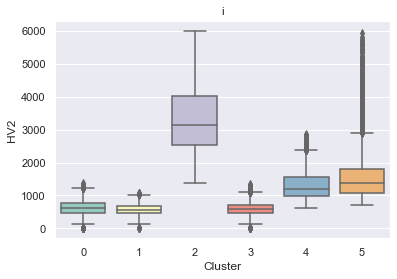

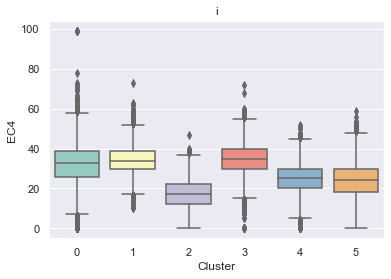

In [31]:
#normalized data

df_plots= df_labeled.iloc[:,:-1]


fig, axes = figsize=(20, 11)

for i in(df_plots.columns):
    sns.boxplot(x = "Cluster", y = i, data=df_labeled, palette="Set3")
    plt.title('i')
    plt.show()

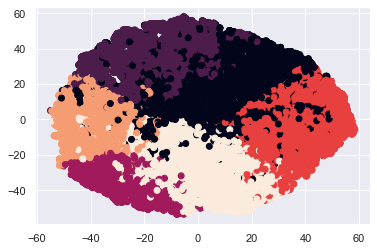

In [32]:
#PLOT, simple base case

from sklearn.manifold import TSNE

tsne = TSNE(random_state=15)
tsne_results = tsne.fit_transform(df_metrics)

tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])

plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df_labeled.Cluster)
plt.show()

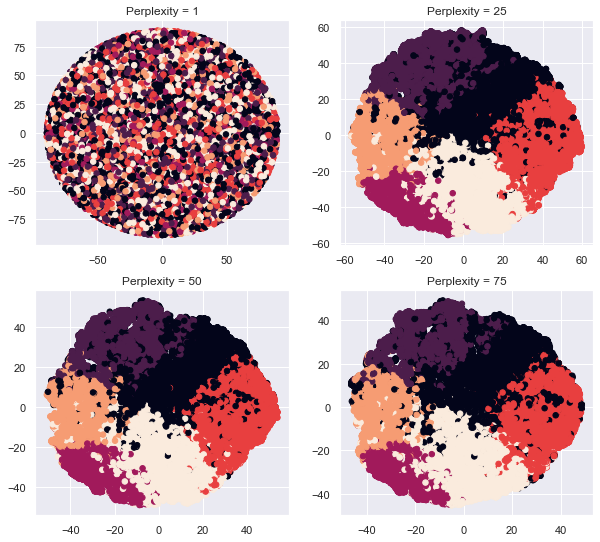

In [33]:
#check different perplexity levels

plt.figure(figsize = (10,5))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 25, 50, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=15)
    tsne_results = tsne.fit_transform(df_metrics)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=df_labeled.Cluster, s=30)
    plt.title('Perplexity = '+ str(p))
plt.show()

### If Everything works properly, one can go back and import the outliers to finish clustering.

In [34]:
#upload clusterable data  outlier data save in step 1
to_clust = pd.read_csv(r'C:\Users\Ricardo Santos\Documents\MSC DM\DM\Proj-DM\common_version\outliers_notstd.csv', low_memory=False)


In [35]:
to_clust=to_clust.set_index('CONTROLN', drop = True).sort_index(axis = 0)
#to_clust

In [36]:
#Shuffle according
to_clust = shuffle(to_clust, random_state = 15)
to_clust
##Remove from to_clust the Variables that were Removed previously from donors
#test1: remove longevity
#to_clust=to_clust[["LONGEVITY","RAMNTALL","NGIFTALL","PROP_RESP_CARDPROM","HHAGE3","HVP4","IC5","EC4", "FEDGOV"]]

,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,LONGEVITY,AGE,...,MAXRAMNT,AVGGIFT,PROP_RESP_CARDPROM,HHAGE3,HV2,HVP4,IC5,EC4,MARR3,AC3
CONTROLN,,,,,,,,,,,,,,,,,,,,,
148153,11,0,26,43,23,6,1,1,180,35.0,...,60.0,8.887714,0.636364,7,3761,99,29413,14,2,7
40411,18,0,42,20,42,6,0,0,72,69.0,...,25.0,25.000000,0.222222,42,2361,99,32092,14,8,17
144676,5,0,19,55,17,10,0,4,180,75.0,...,21.0,7.571429,0.677419,17,1454,98,10573,35,6,11
176099,2,1,27,42,22,6,16,3,168,49.0,...,7.0,4.842105,0.612903,21,542,8,10313,37,5,7
157646,1,0,25,35,35,6,4,0,96,63.0,...,42.0,28.400000,0.157895,39,2543,98,19115,27,12,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133879,0,0,39,31,25,7,10,2,180,47.0,...,50.0,25.000000,0.166667,17,699,31,10395,40,4,11
44124,1,0,37,36,43,11,2,2,180,17.0,...,10.0,4.000000,0.535714,41,710,28,15111,29,12,11
166862,7,0,24,29,35,6,3,0,72,73.0,...,35.0,27.500000,0.181818,12,4197,99,32773,9,3,11


In [37]:
#remove avggift, Longevity and STATEGOV
 
to_clust = to_clust[["LONGEVITY","RAMNTALL","NGIFTALL","PROP_RESP_CARDPROM","HVP4","HV2","EC4"]]

In [38]:
#re-scale and normalize

# Get column names first
namers = to_clust.columns

# Create the Scaler object

scaler = preprocessing.StandardScaler()

# Fit your data on the scaler object

scaled_clust = scaler.fit_transform(to_clust)
scaled_clust = pd.DataFrame(scaled_clust, columns=names)
  
# Normalizing the Data 
normalized_clust = normalize(scaled_clust) 
  
# Converting the numpy array into a pandas DataFrame 
df_clust = pd.DataFrame(normalized_clust,columns=names) 

# Predicting: Normalized Data

In [39]:
#copy normalized_clust
normie_with_label = to_clust.copy()

In [40]:
normie_with_label

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4
CONTROLN,,,,,,,
148153,180,311.07,35,0.636364,99,3761,14
40411,72,75.00,3,0.222222,99,2361,14
144676,180,371.00,49,0.677419,98,1454,35
176099,168,184.00,38,0.612903,8,542,37
157646,96,142.00,5,0.157895,98,2543,27
...,...,...,...,...,...,...,...
133879,180,225.00,9,0.166667,31,699,40
44124,180,96.00,24,0.535714,28,710,29
166862,72,55.00,2,0.181818,99,4197,9


In [41]:
#Predict cluster 
labelsx = gmm.predict(normalized_clust)
normie_with_label['Cluster'] = labelsx

In [42]:
#predict probability
probs_gmmx = gmm.predict_proba(df_clust)

In [43]:
probs_gmmx

array([[1.78961814e-030, 5.14271866e-216, 2.99605441e-002,
        1.72082406e-109, 2.80089464e-039, 9.70039456e-001],
       [2.99788217e-011, 1.74145061e-039, 1.24185556e-001,
        1.48452138e-104, 8.73802369e-001, 2.01207513e-003],
       [1.95679965e-003, 6.43379015e-132, 3.51960965e-050,
        1.67574627e-001, 1.11165305e-079, 8.30468574e-001],
       ...,
       [3.96862038e-033, 1.25295597e-118, 9.99889435e-001,
        2.47526946e-183, 7.75549473e-005, 3.30101966e-005],
       [5.92273574e-003, 4.20749256e-127, 6.31245596e-069,
        9.68613092e-001, 1.82447002e-089, 2.54641728e-002],
       [2.73984095e-035, 6.25030399e-218, 3.52932305e-002,
        1.32555805e-135, 2.93590006e-034, 9.64706770e-001]])

In [44]:
#test - Silhouette score
sklearn.metrics.silhouette_score(df_clust, labelsx, random_state=15)

0.11475806839518687

In [45]:
#calinski harabaz
calinski_harabasz_score(normalized_clust, labelsx)

1905.500128304344

In [46]:
sst = get_ss(to_clust)  # get total sum of squares
ssw_labels = normie_with_label.groupby(['Cluster']).apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
r2

0.7317130923061854

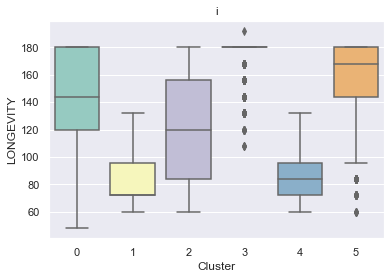

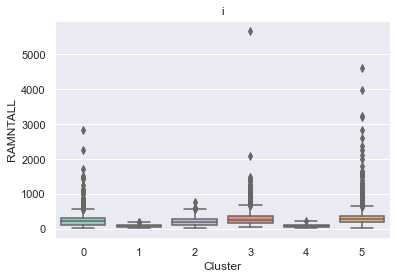

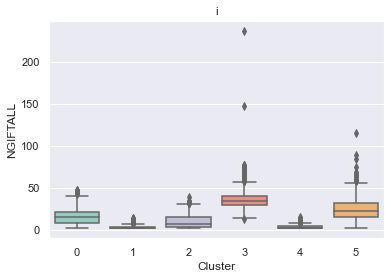

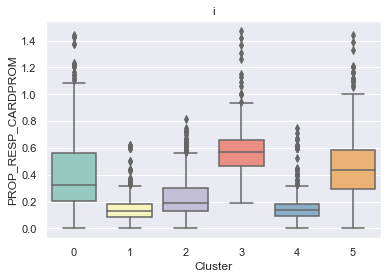

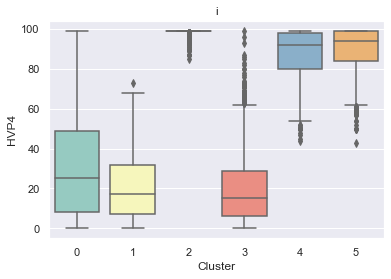

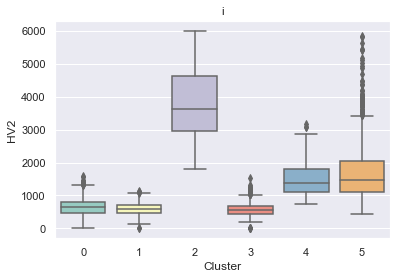

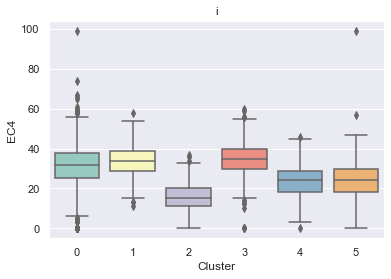

In [47]:
#normalized data

df_plots2= normie_with_label.iloc[:,:-1]


fig, axes = figsize=(20, 11)

for i in(df_plots.columns):
    sns.boxplot(x = "Cluster", y = i, data=normie_with_label, palette="Set3")
    plt.title('i')
    plt.show()

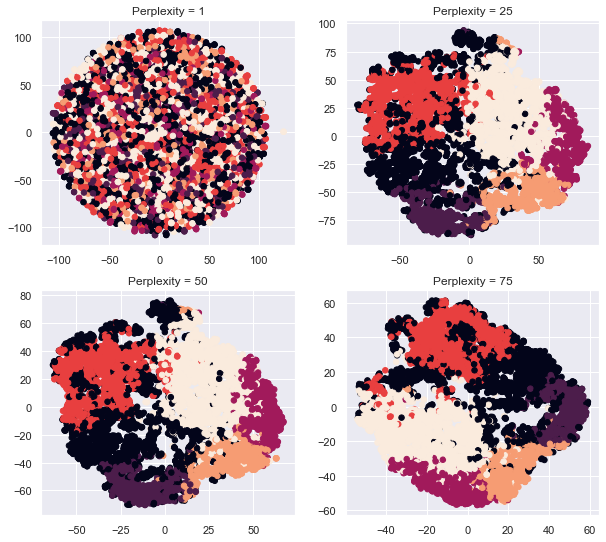

In [49]:
#PLOT 

plt.figure(figsize = (10,5))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 25, 50, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=15)
    tsne_results = tsne.fit_transform(normalized_clust)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=normie_with_label.Cluster, s=30)
    plt.title('Perplexity = '+ str(p))
plt.show()

In [50]:
df_labeled

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4,Cluster
CONTROLN,,,,,,,,
65695,84,30.0,2,0.000000,68,820,21,4
42239,180,155.0,19,0.258065,10,465,31,3
130378,180,243.0,26,0.575758,80,1144,33,3
45755,96,61.0,7,0.333333,94,1240,26,5
122970,120,49.0,10,0.176471,38,742,38,0
...,...,...,...,...,...,...,...,...
142252,180,58.0,16,0.407407,99,1472,34,5
13419,84,198.0,22,0.555556,98,1150,23,5
28847,120,70.0,5,0.166667,17,503,40,0


In [51]:
normie_with_label

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4,Cluster
CONTROLN,,,,,,,,
148153,180,311.07,35,0.636364,99,3761,14,5
40411,72,75.00,3,0.222222,99,2361,14,4
144676,180,371.00,49,0.677419,98,1454,35,5
176099,168,184.00,38,0.612903,8,542,37,3
157646,96,142.00,5,0.157895,98,2543,27,2
...,...,...,...,...,...,...,...,...
133879,180,225.00,9,0.166667,31,699,40,0
44124,180,96.00,24,0.535714,28,710,29,3
166862,72,55.00,2,0.181818,99,4197,9,2


In [52]:
df_labeled = df_labeled.append(normie_with_label)

In [53]:
df_labeled

,LONGEVITY,RAMNTALL,NGIFTALL,PROP_RESP_CARDPROM,HVP4,HV2,EC4,Cluster
CONTROLN,,,,,,,,
65695,84,30.0,2,0.000000,68,820,21,4
42239,180,155.0,19,0.258065,10,465,31,3
130378,180,243.0,26,0.575758,80,1144,33,3
45755,96,61.0,7,0.333333,94,1240,26,5
122970,120,49.0,10,0.176471,38,742,38,0
...,...,...,...,...,...,...,...,...
133879,180,225.0,9,0.166667,31,699,40,0
44124,180,96.0,24,0.535714,28,710,29,3
166862,72,55.0,2,0.181818,99,4197,9,2


In [54]:
df_labeled.to_csv('GMM_labels.csv')